In [ ]:
!pip install sentence-transformers
!pip install umap-learn
!pip install hdbscan

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#------------------------------------------------------------------
import pandas as pd
import numpy as np
import random

df = pd.read_csv("/content/drive/MyDrive/COVID_News/chopped_news.csv.gz")
print(df.head)

data_news = list(set(df.iloc[random.sample(range(len(df)), int(1e5))]["text"].tolist()))

del df

<bound method NDFrame.head of                                                      text
0       This year's Budget statement will be delivered...
1       Trump has frequently complained about the Fed ...
2       Cynthia Jasso’s work in philanthropy—including...
3       SHANGHAI (Reuters) - The majority of U.S. firm...
4       UNITED NATIONS, (UrduPoint / Pakistan Point Ne...
...                                                   ...
496417  Coronavirus pandemic: Police reactivates 724 P...
496418  With few exceptions, St. Louis-area libraries ...
496419  Members of the New York Congressional delegati...
496420  The impact of the lockdown could be gauged onl...
496421  As communities across Illinois grapple with th...

[496422 rows x 1 columns]>


In [ ]:
# converting the documents to numerical data
# https://towardsdatascience.com/topic-modeling-with-bert-779f7db187e6
from sentence_transformers import SentenceTransformer

# https://www.sbert.net/docs/pretrained_models.html
model = SentenceTransformer('all-MiniLM-L6-v2')

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
embedding_news = model.encode(data_news, show_progress_bar=True)

Batches:   0%|          | 0/15417 [00:00<?, ?it/s]

In [ ]:
import pickle

with open('/content/drive/MyDrive/COVID_News/news_embedding.pickle', 'wb') as pkl:
    pickle.dump(embedding_news, pkl)

In [ ]:
import pickle

with open('/content/drive/MyDrive/COVID_News/news_embedding.pickle', 'rb') as pkl:
    embedding_news = pickle.load(pkl)

In [ ]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
%matplotlib inline

"""
https://umap-learn.readthedocs.io/en/latest/parameters.html
low values of n_neighbors will force UMAP to concentrate on very local structure 
(potentially to the detriment of the big picture), while large values will push UMAP to 
look at larger neighborhoods of each point when estimating the manifold structure of the data, 
losing fine detail structure for the sake of getting the broader of the data
"""

# default min_dist of 0.1 is good enough
umap_embeddings1 = umap.UMAP(n_neighbors=15, # this is high enough based on umap examples
                            n_components=2,
                            metric='cosine').fit_transform(embedding_news)

draw_umap(umap_embeddings1, 2, title='n_components=2')

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


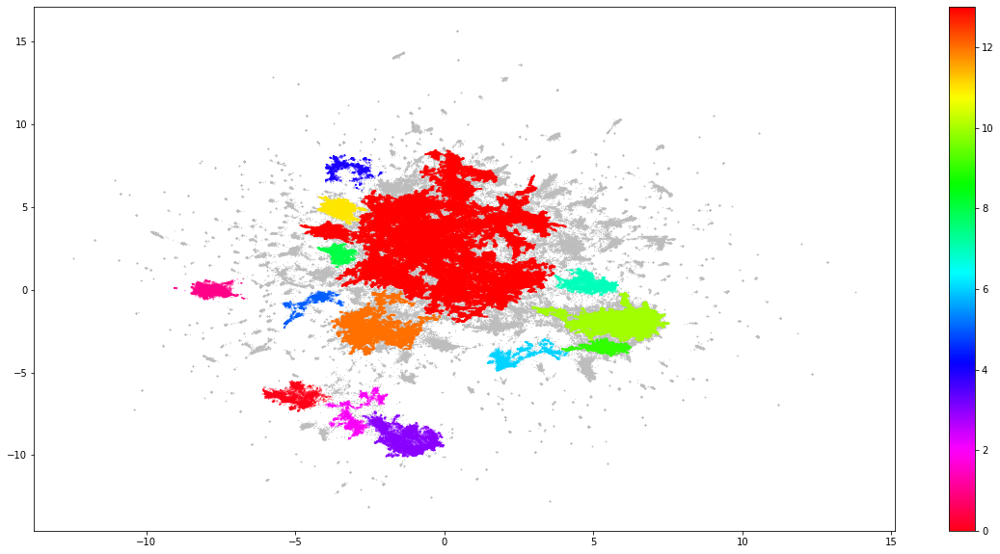

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import hdbscan
import numpy as np

umap_embeddings = np.load("/content/drive/MyDrive/COVID_News/umap_embeddings_n2_nbr15.npy")

cluster = hdbscan.HDBSCAN(min_cluster_size=5000,
                          min_samples=20,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

# Prepare data
umap_data = umap_embeddings
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv_r')
plt.colorbar()

In [ ]:
!pip install bertopic

In [ ]:
from bertopic import BERTopic
import random

topic_model = BERTopic()
topics, probs = topic_model.fit_transform(data_news)

In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,41290,-1_and_to_of_are
1,0,1086,0_wuhan_hubei_china_beijing
2,1,888,1_her_she_died_nurse
3,2,710,2_exams_students_exam_class
4,3,653,3_pompeo_china_chinese_beijing
...,...,...,...
1025,1038,10,1038_book_books_nightstand_authors
1024,1039,10,1039_bame_ethnicity_black_die
1023,1040,10,1040_bok_kdb_koreas_juyeol
1022,1041,10,1041_jrs_hydroxychloroquine_surabian_twitter


In [ ]:
topic_model.get_topic(0)

[('wuhan', 0.014642598787968034),
 ('hubei', 0.009887537486195173),
 ('china', 0.007955979229583066),
 ('beijing', 0.007696443788860387),
 ('province', 0.007442954238349924),
 ('chinese', 0.006899789386770903),
 ('chinas', 0.0057892629565997515),
 ('mainland', 0.005584770185526722),
 ('commission', 0.005285206801940361),
 ('imported', 0.003988242399752205)]

In [ ]:
topic_model.get_topic(1)

[('her', 0.007408616216643456),
 ('she', 0.006250061355823262),
 ('died', 0.005203342952069479),
 ('nurse', 0.004872204454959786),
 ('mother', 0.004422958387044381),
 ('hospital', 0.00430611717683211),
 ('family', 0.0037977029211427996),
 ('baby', 0.0035011655405876095),
 ('husband', 0.0033971441712913946),
 ('daughter', 0.0033684920688014388)]

In [ ]:
topic_model.get_topic(2)

[('exams', 0.01722463897797607),
 ('students', 0.015664777156886123),
 ('exam', 0.013168891172326598),
 ('class', 0.012363598563641848),
 ('examinations', 0.011899212939114688),
 ('education', 0.011136293440470424),
 ('board', 0.010511661012706073),
 ('examination', 0.010203397476609416),
 ('cbse', 0.00822706535189933),
 ('secondary', 0.007287446528604004)]

In [ ]:
topic_model.get_topic(3)

[('pompeo', 0.010200819243259069),
 ('china', 0.010027140593251684),
 ('chinese', 0.00968655707950958),
 ('beijing', 0.007419412728280051),
 ('chinas', 0.0059120089513259606),
 ('communist', 0.00524979094019963),
 ('xi', 0.00489296218531079),
 ('trump', 0.004584952389684644),
 ('mike', 0.0038871008385345227),
 ('us', 0.0038166288537676597)]

In [ ]:
topic_model.get_topic(4)

[('music', 0.012597040513650282),
 ('album', 0.009779687096380545),
 ('festival', 0.008071666270017389),
 ('concert', 0.007734832875856196),
 ('song', 0.006447720481823303),
 ('artists', 0.006006881827095771),
 ('concerts', 0.005503088415824179),
 ('musicians', 0.004392833406294142),
 ('songs', 0.004361526866000186),
 ('gaga', 0.00431487201176711)]

In [ ]:
topic_model.get_topic(5)

[('auto', 0.010186488327199754),
 ('motor', 0.008845755461567904),
 ('car', 0.008519142694354446),
 ('plants', 0.007830816003241228),
 ('sales', 0.0076754538632002635),
 ('automakers', 0.007511973341490528),
 ('production', 0.007208341872522742),
 ('fiat', 0.006980679699755166),
 ('ford', 0.006783087645114688),
 ('vehicles', 0.006758548155488103)]

In [ ]:
topic_model.get_topic(6)

[('biden', 0.034199967165239126),
 ('sanders', 0.019338988603515087),
 ('joe', 0.018200063366315373),
 ('democratic', 0.016386821301676163),
 ('presidential', 0.013075516555787755),
 ('bernie', 0.01288798403871098),
 ('vice', 0.009675190520455975),
 ('campaign', 0.008719854303278929),
 ('nominee', 0.008624297941296264),
 ('bidens', 0.00851144714385043)]

In [ ]:
topic_model.get_topic(7)

[('baseball', 0.024855641856341378),
 ('mlb', 0.015611351322409234),
 ('yankees', 0.010354564239249443),
 ('season', 0.008780968067454627),
 ('league', 0.00856027138994074),
 ('players', 0.008135278155011402),
 ('marlins', 0.006131124566323992),
 ('major', 0.005810674668416952),
 ('phillies', 0.005713293920461396),
 ('pitcher', 0.005666691416153567)]

In [ ]:
topic_model.get_topic(8)

[('italy', 0.022374064780786185),
 ('italian', 0.011480896958667396),
 ('rome', 0.011169038342602747),
 ('italys', 0.010975134238153885),
 ('lombardy', 0.009071972114334864),
 ('conte', 0.007538127722493743),
 ('milan', 0.007270509446089646),
 ('giuseppe', 0.005775265260380057),
 ('italians', 0.005667345512226654),
 ('ansa', 0.004448331230851867)]

In [ ]:
topic_model.get_topic(9)

[('nfl', 0.02845510448948012),
 ('draft', 0.013893147156979792),
 ('quarterback', 0.009308571720720901),
 ('teams', 0.006899157352740288),
 ('players', 0.006646184194952426),
 ('brady', 0.006589489833768065),
 ('offseason', 0.00629180693274966),
 ('cowboys', 0.005566088981363145),
 ('patriots', 0.005545155536069569),
 ('season', 0.005423360462569361)]

In [ ]:
topic_model.get_topic(10)

[('movie', 0.01719636914016033),
 ('theaters', 0.014696679860106462),
 ('film', 0.014420129661205048),
 ('amc', 0.00881707477705142),
 ('films', 0.008574764902176747),
 ('cinemas', 0.007967729823985803),
 ('movies', 0.007237556168749957),
 ('release', 0.006986978577431662),
 ('tenet', 0.00691066603200259),
 ('theater', 0.006718966632261698)]

In [ ]:
topic_model.get_topic(11)

[('call', 0.034323455901392595),
 ('operator', 0.025899535051843618),
 ('thank', 0.022944415597837813),
 ('welcome', 0.022725065180547222),
 ('conference', 0.022502215335006605),
 ('earnings', 0.021806160596074268),
 ('remarks', 0.018651756147356213),
 ('instructions', 0.018390518451559375),
 ('relations', 0.017126906570969526),
 ('investor', 0.016124631736749617)]

In [ ]:
topic_model.get_topic(12)

[('nba', 0.030149894763238237),
 ('players', 0.009170749736300844),
 ('basketball', 0.008766665814115409),
 ('lakers', 0.00839262105050511),
 ('gobert', 0.008093126626517847),
 ('orlando', 0.008013762534998343),
 ('jazz', 0.0066550531379925715),
 ('season', 0.006572394428769288),
 ('nbas', 0.006040127273958361),
 ('nets', 0.005782702945421631)]

In [ ]:
topic_model.get_topic(13)

[('manchester', 0.011945443137432463),
 ('arsenal', 0.010640873717505696),
 ('transfer', 0.009480593486004016),
 ('pogba', 0.008750681470002599),
 ('sancho', 0.008396614883352256),
 ('dortmund', 0.007975817988490518),
 ('solskjaer', 0.007889465937252305),
 ('club', 0.007837374424265995),
 ('barcelona', 0.007284647924167963),
 ('gunnar', 0.006941809151881634)]

In [ ]:
topic_model.get_topic(14)

[('lagos', 0.019054277600806687),
 ('nigeria', 0.019025754377748363),
 ('ncdc', 0.008779850077924641),
 ('buhari', 0.008530981439006944),
 ('nigerians', 0.008059295809091697),
 ('abuja', 0.007644388614024275),
 ('state', 0.007247651620759007),
 ('kano', 0.006791419376011166),
 ('governor', 0.006636806420308933),
 ('muhammadu', 0.006374611472840252)]

In [ ]:
topic_model.get_topic(15)

[('victoria', 0.01449426369611474),
 ('nsw', 0.01105906357373008),
 ('melbourne', 0.008826925891683653),
 ('andrews', 0.00832962853537079),
 ('australia', 0.008303314882171835),
 ('queensland', 0.006371526027573276),
 ('sydney', 0.0057695975858735385),
 ('premier', 0.005208933014072988),
 ('border', 0.005086829178139065),
 ('tasmania', 0.004843161043301915)]

In [ ]:
topic_model.get_topic(16)

[('dow', 0.02634580075417951),
 ('sp', 0.0184288669498215),
 ('jones', 0.015634101548819536),
 ('points', 0.014900467183657805),
 ('500', 0.014168915186631863),
 ('nasdaq', 0.013788894390335243),
 ('industrial', 0.012377582765505593),
 ('average', 0.01037207503926088),
 ('stocks', 0.010136850288889238),
 ('composite', 0.010015397502220962)]

In [ ]:
topic_model.get_topic(17)

[('zealand', 0.020929377531019512),
 ('ardern', 0.015201902958419358),
 ('jacinda', 0.012842778250294421),
 ('alert', 0.007862410881576144),
 ('zealands', 0.007336520396332007),
 ('auckland', 0.007278088446411325),
 ('bloomfield', 0.007141368688558523),
 ('level', 0.007004002837340951),
 ('wellington', 0.0066635590961158205),
 ('zealanders', 0.006285957629322316)]

In [ ]:
topic_model.get_topic(18)

[('pelosi', 0.020762854475015653),
 ('senate', 0.01938268740421259),
 ('mcconnell', 0.016024497648286222),
 ('nancy', 0.014829254792685025),
 ('bill', 0.014232189421448422),
 ('house', 0.013769835768334349),
 ('democrats', 0.01374407482547584),
 ('speaker', 0.012848818622454374),
 ('mitch', 0.011573111753429796),
 ('leader', 0.009649989368202633)]

In [ ]:
topic_model.get_topic(19)

[('lockdown', 0.011485956440606071),
 ('modi', 0.00972830199538922),
 ('till', 0.007775795471363196),
 ('narendra', 0.006967052995356136),
 ('zones', 0.004883559428790453),
 ('minister', 0.004877863843688076),
 ('delhi', 0.004423165192020467),
 ('prime', 0.004189636642676865),
 ('guidelines', 0.004052921785939583),
 ('chief', 0.004030912979205661)]

In [ ]:
topic_model.get_topic(20)

[('newsom', 0.016352698698950185),
 ('county', 0.016088653857105624),
 ('california', 0.012073834550445549),
 ('gavin', 0.010248644237597124),
 ('homeless', 0.008258413861569924),
 ('angeles', 0.008103783467540492),
 ('los', 0.008059223787133045),
 ('san', 0.008054636492842224),
 ('counties', 0.006805873688728134),
 ('francisco', 0.006045275206665346)]

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart()

In [ ]:
topic_model.visualize_heatmap()

# New

In [ ]:
!pip install bertopic

In [ ]:
from bertopic import BERTopic

topic_model2 = BERTopic(nr_topics="auto")
topics, probs = topic_model2.fit_transform(data_news)

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


In [ ]:
topic_model2.get_topic_info()

,Topic,Count,Name
0,-1,39660,-1_and_to_of_the
1,0,1939,0_wuhan_china_chinese_beijing
2,1,1408,1_canada_ottawa_trudeau_ontario
3,2,1052,2_her_she_hospital_died
4,3,1034,3_biden_trump_joe_sanders
...,...,...,...
564,572,10,572_bear_bears_cubs_takoda
563,573,10,573_travel_advisory_china_pompeo
562,574,10,574_cdc_previous_count_necessarily
561,568,10,568_christmas_darwin_australians_island


In [ ]:
for i in range(20):
  print(i)
  print(topic_model2.get_topic(i))

0
[('wuhan', 0.014173724503619084), ('china', 0.012614171339973274), ('chinese', 0.010573699441146747), ('beijing', 0.00999784126679717), ('chinas', 0.00827512602491135), ('hubei', 0.007544583613241724), ('province', 0.006256239061018961), ('outbreak', 0.004728764318781856), ('virus', 0.004155735157687451), ('commission', 0.004067418002983953)]
1
[('canada', 0.010281021474012289), ('ottawa', 0.009677911844690643), ('trudeau', 0.009314265802834525), ('ontario', 0.008810965340841817), ('province', 0.008535949839776662), ('quebec', 0.007784485241164252), ('bc', 0.007169065331646351), ('cbcca', 0.0062448591917762175), ('montreal', 0.006093216107807572), ('canadian', 0.005990730713596248)]
2
[('her', 0.012445465339555806), ('she', 0.01055167552292427), ('hospital', 0.00757577316187499), ('died', 0.007068409385967181), ('nurse', 0.00632734673965815), ('family', 0.004896860486173745), ('was', 0.004644333693656287), ('mother', 0.004150254585099987), ('daughter', 0.0037973520717383994), ('his',

In [ ]:
from bertopic import BERTopic

topic_model3 = BERTopic(nr_topics=10)
topics3, probs3 = topic_model3.fit_transform(data_news)

In [ ]:
topic_model3.get_topic_info()

,Topic,Count,Name
0,-1,83824,-1_the_to_of_and
1,0,2713,0_the_in_of_to
2,1,2420,1_the_trump_to_president
3,2,1845,2_oil_the_in_to
4,3,1562,3_the_of_investors_and
5,4,1482,4_the_her_in_and
6,5,1318,5_her_the_she_and
7,6,1245,6_the_league_to_premier
8,7,1213,7_the_manila_of_philippines
9,8,1122,8_airlines_the_to_airline


In [ ]:
for i in range(10):
  print(i)
  print(topic_model3.get_topic(i))

0
[('the', 0.06158121303392052), ('in', 0.04628458811468565), ('of', 0.045405311033033344), ('to', 0.03813603963339101), ('china', 0.03584344648708757), ('and', 0.032532187524011096), ('on', 0.02675315402163352), ('wuhan', 0.024262881545623814), ('coronavirus', 0.023808138742787033), ('from', 0.022168401050550124)]
1
[('the', 0.05687361777311476), ('trump', 0.04493962241441635), ('to', 0.04120466370327613), ('president', 0.03753357363168227), ('of', 0.03721742972047316), ('in', 0.033504212200787385), ('and', 0.03296963323236322), ('that', 0.028516057060789458), ('on', 0.02740394627068515), ('biden', 0.02431873686363614)]
2
[('oil', 0.05414017266978187), ('the', 0.05224279060909293), ('in', 0.04032619110490457), ('to', 0.03702362279326719), ('prices', 0.03618809905718464), ('on', 0.0350993496556859), ('of', 0.0345977676891373), ('and', 0.030470408206235915), ('as', 0.030193814762960725), ('gold', 0.029060247368787633)]
3
[('the', 0.05752257407867131), ('of', 0.03443146757096196), ('inve